In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip /content/drive/MyDrive/Inference.zip

Archive:  /content/drive/MyDrive/Inference.zip
   creating: Images/
   creating: Models/
   creating: YOLOv5_results/
   creating: YOLOv8_results/
  inflating: YOLOv8_results/result_33.jpg  
  inflating: YOLOv8_results/result_23.jpg  
  inflating: YOLOv8_results/result_16.jpg  
  inflating: YOLOv8_results/result_31.jpg  
  inflating: YOLOv8_results/result_39.jpg  
  inflating: YOLOv8_results/result_35.jpg  
  inflating: YOLOv8_results/result_17.jpg  
  inflating: YOLOv8_results/result_3.jpg  
  inflating: YOLOv8_results/result_21.jpg  
  inflating: YOLOv8_results/result_0.jpg  
  inflating: YOLOv8_results/result_14.jpg  
  inflating: YOLOv8_results/result_28.jpg  
  inflating: YOLOv8_results/result_5.jpg  
  inflating: YOLOv8_results/result_9.jpg  
  inflating: YOLOv8_results/result_34.jpg  
  inflating: YOLOv8_results/result_12.jpg  
  inflating: YOLOv8_results/result_37.jpg  
  inflating: YOLOv8_results/result_10.jpg  
  inflating: YOLOv8_results/result_29.jpg  
  inflating: YOLOv8_r

In [3]:
!pip install grad-cam ultralytics
!pip install pytorch-grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 64.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.8/898.8 kB 48.6 MB/s eta 0:00:00
  Created wheel for grad-cam: filename=grad_cam-1.5.4-py3-none-any.whl size=39588 sha256=c9c35fff3c975aa62c61b17cdf223c4234527ccac9a473a44a0632c04adb64d8
  Stored in directory: /root/.cache/pip/wheels/50/b0/82/1f97b5348c7fe9f0ce0ba18497202cafa5dec4562bd5292680
Successfully built grad-cam
ERROR: Could not find a version that satisfies the requirement pytorch-grad-cam (from versions: none)
ERROR: No matching distribution found for pytorch-grad-cam


In [4]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import torch
import cv2
import numpy as np
import os
from PIL import Image
from ultralytics import YOLO
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.



0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 33.8ms
Speed: 13.7ms preprocess, 33.8ms inference, 885.0ms postprocess per image at shape (1, 3, 512, 640)


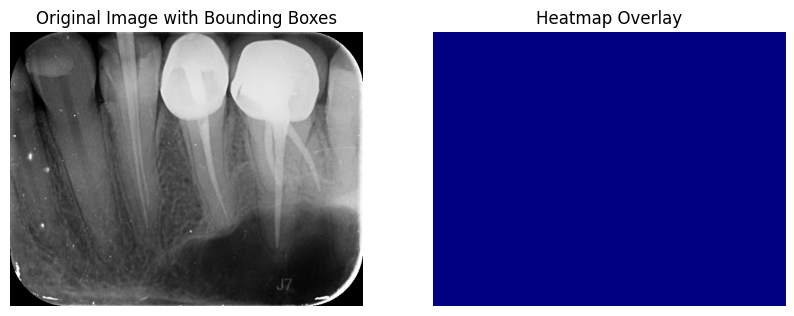

Processed and saved: ImageFile_8fa23452-8011-459e-990d-e4c191786582_000001811.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 18.6ms
Speed: 3.5ms preprocess, 18.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


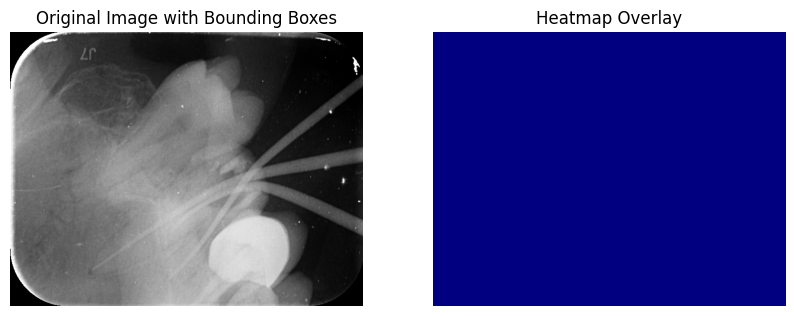

Processed and saved: ImageFile_68ac7f1f-8b34-40f4-ac07-59c85d7388d4_000001745.png

0: 640x512 2 Complete endodontic treatments, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 46.0ms
Speed: 3.2ms preprocess, 46.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 512)


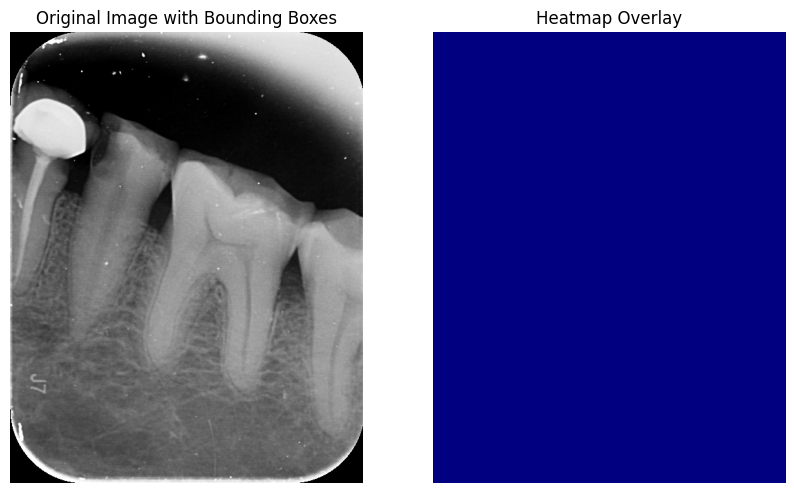

Processed and saved: ImageFile_1bcb6cd0-8b3a-483f-8b5b-0fc24c2c61a3_000001387.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.7ms
Speed: 3.3ms preprocess, 12.7ms inference, 2.7ms postprocess per image at shape (1, 3, 512, 640)


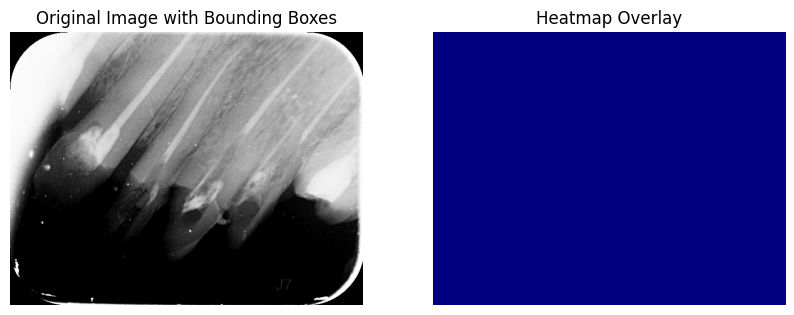

Processed and saved: ImageFile_80af4b6a-a214-49a7-b657-29faf3a500c6_000002101.png

0: 448x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 53.2ms
Speed: 3.2ms preprocess, 53.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


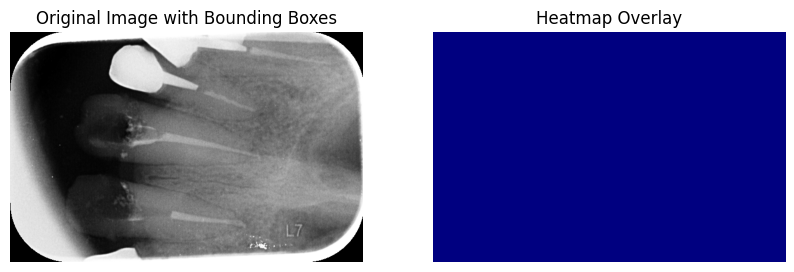

Processed and saved: ImageFile_1d4a6ff3-47bd-4a12-a72a-712ac8fe25b1_000002193.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 15.2ms
Speed: 3.4ms preprocess, 15.2ms inference, 4.8ms postprocess per image at shape (1, 3, 512, 640)


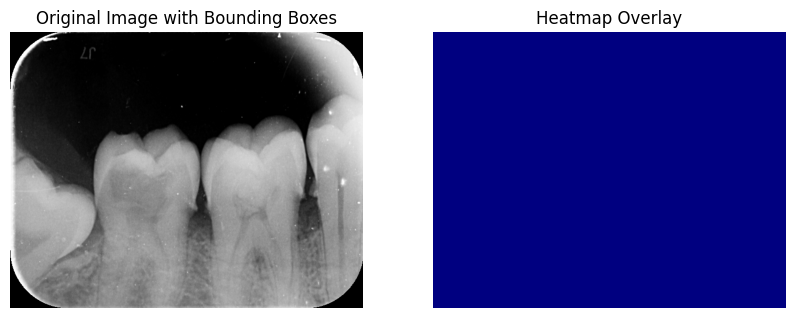

Processed and saved: ImageFile_2cb9a1dc-3f64-4366-90b8-387e3c2c88c5_000002017.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.9ms
Speed: 3.3ms preprocess, 12.9ms inference, 3.7ms postprocess per image at shape (1, 3, 512, 640)


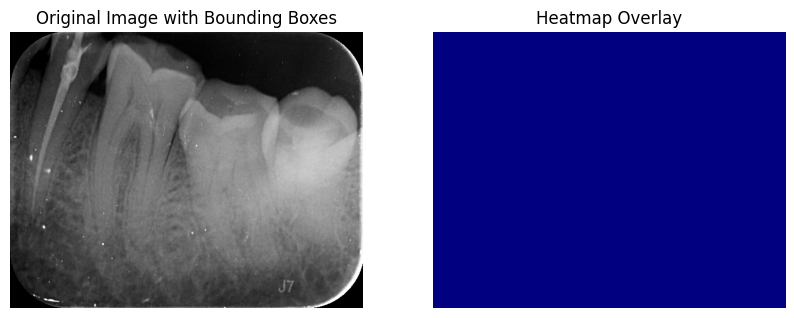

Processed and saved: ImageFile_1b8b6bf2-fb10-403b-b7b5-98f19c59b869_000000687.png

0: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 120.5ms
Speed: 3.0ms preprocess, 120.5ms inference, 4.7ms postprocess per image at shape (1, 3, 416, 640)


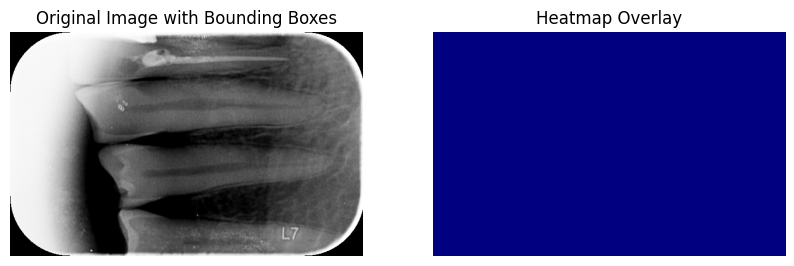

Processed and saved: ImageFile_7d480b1e-d50c-4dac-b733-bb2e6019b18e_000001689.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 18.5ms
Speed: 5.4ms preprocess, 18.5ms inference, 6.7ms postprocess per image at shape (1, 3, 512, 640)


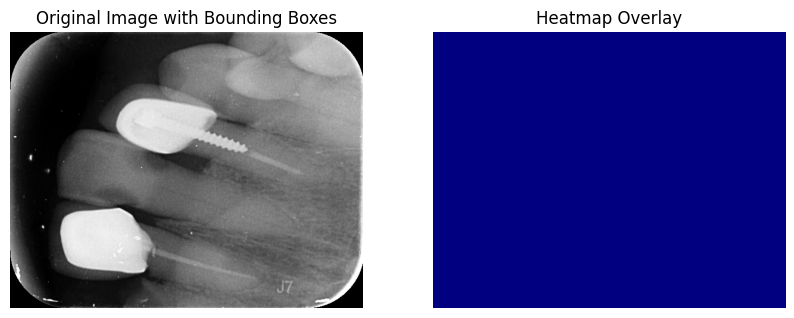

Processed and saved: ImageFile_0ed3b649-650b-4ec0-b630-1eaf41872b1d_000001883.png

0: 416x640 1 Complete endodontic treatment, 2 No endodontic treatments, 2 Incomplete endodontic treatments, 1 Total endodontic failure, 21.9ms
Speed: 3.9ms preprocess, 21.9ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


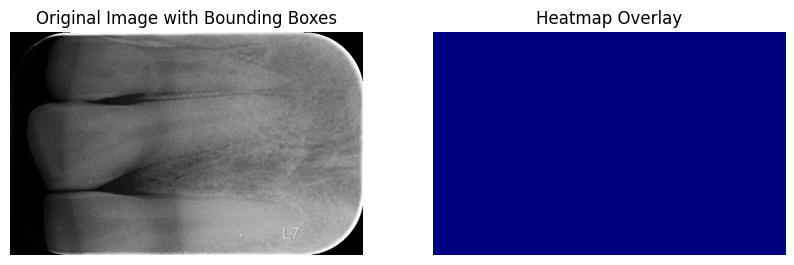

Processed and saved: ImageFile_3a270fb4-5be2-47a4-bdd7-c2efb7629409_000000977.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.5ms
Speed: 3.2ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


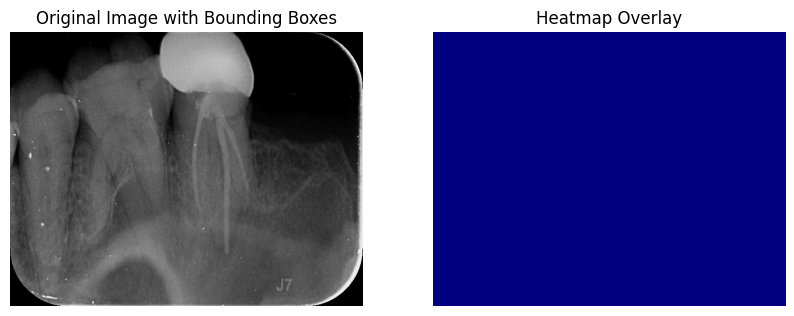

Processed and saved: ImageFile_0a8f991d-8d12-416e-ba05-b19d8296bdce_000000541.png

0: 576x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Total endodontic failure, 81.6ms
Speed: 3.4ms preprocess, 81.6ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)


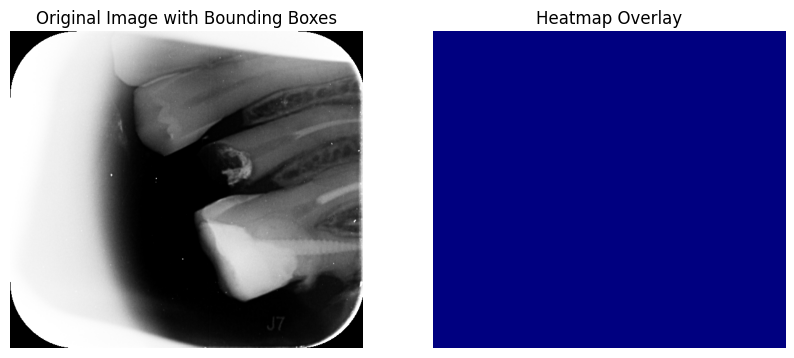

Processed and saved: ImageFile_9a5a780f-1e93-4f33-ac66-7d3f2f175278_000000347.png

0: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 18.3ms
Speed: 2.7ms preprocess, 18.3ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


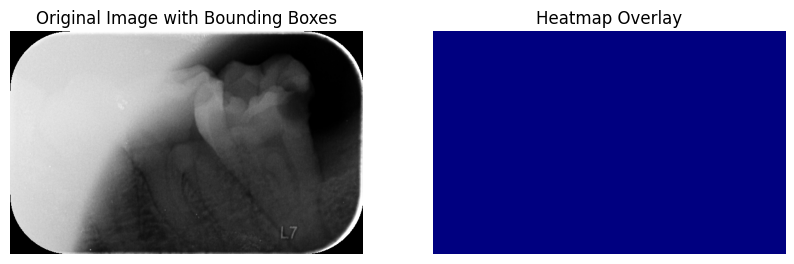

Processed and saved: ImageFile_2b11eb83-0d85-4802-b3b9-e522f5163f21_000001863.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 15.4ms
Speed: 7.2ms preprocess, 15.4ms inference, 6.7ms postprocess per image at shape (1, 3, 512, 640)


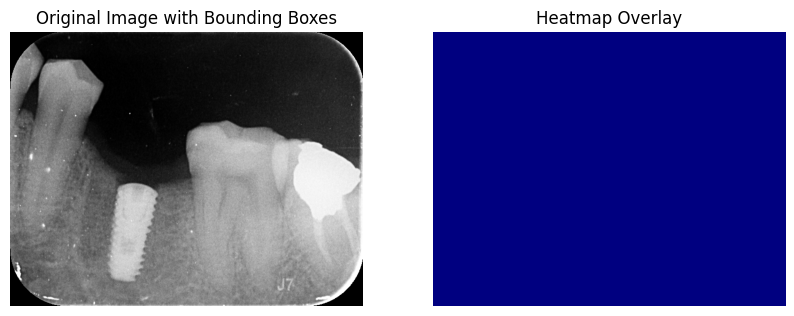

Processed and saved: ImageFile_2fd65142-fab7-4151-bc25-c8c3c67895f2_000001525.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.0ms
Speed: 3.5ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


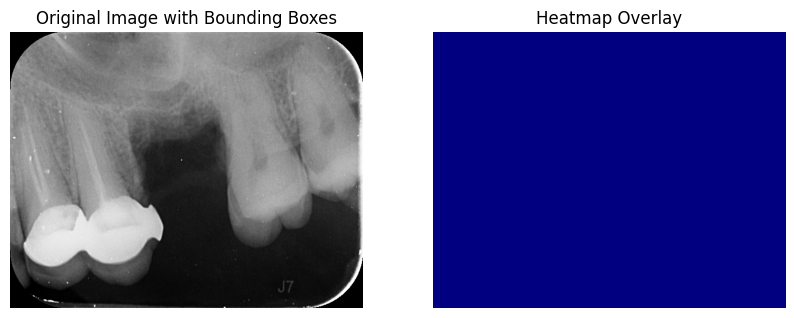

Processed and saved: 001336.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 14.3ms
Speed: 3.3ms preprocess, 14.3ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


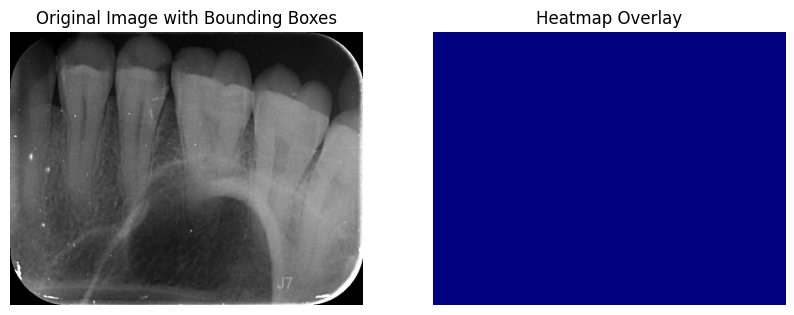

Processed and saved: ImageFile_02d8cab9-d575-42ba-918a-34533596e006_000001489.png

0: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 2 Incomplete endodontic treatments, 1 Total endodontic failure, 11.8ms
Speed: 1.7ms preprocess, 11.8ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


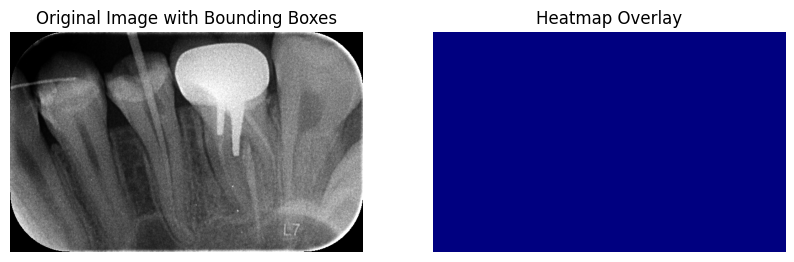

Processed and saved: ImageFile_78a3c7f1-c144-4d24-b158-fdabc5ce490d_000001241.png

0: 640x416 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 2 Total endodontic failures, 58.0ms
Speed: 2.6ms preprocess, 58.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 416)


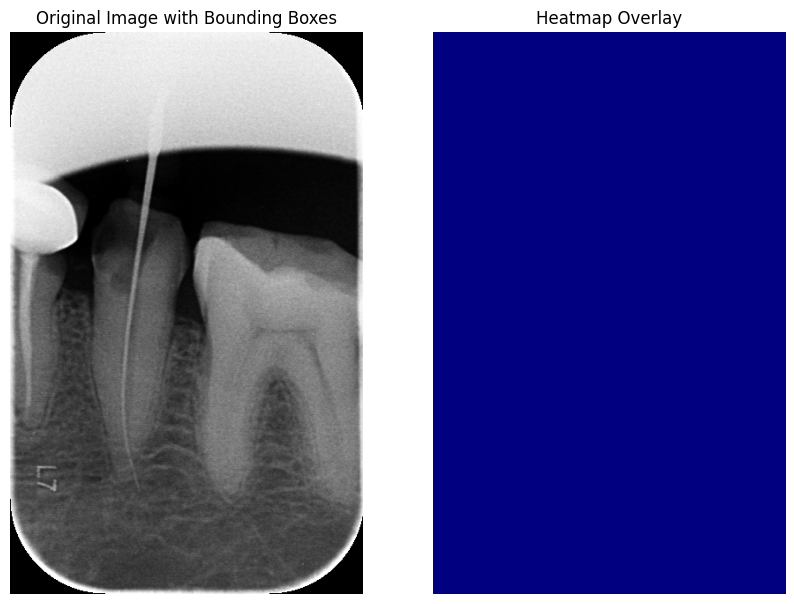

Processed and saved: ImageFile_7b35f871-f4c6-4e35-a214-cd3b64ce5c56_000001461.png

0: 512x640 2 Complete endodontic treatments, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 2 Total endodontic failures, 14.9ms
Speed: 3.2ms preprocess, 14.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


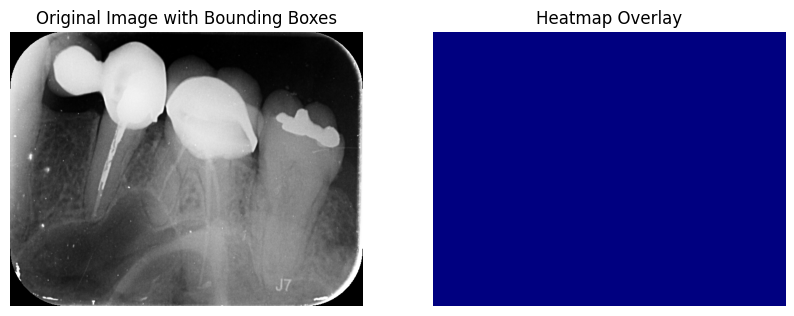

Processed and saved: ImageFile_8c86fde0-f3e6-4032-91d9-eba9b5f6142c_000001953.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 15.0ms
Speed: 3.4ms preprocess, 15.0ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


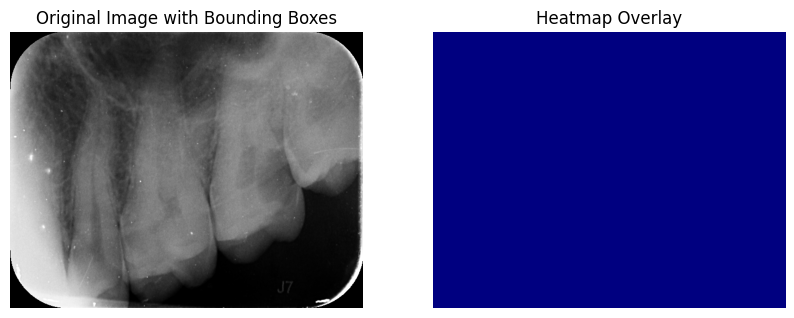

Processed and saved: ImageFile_2b643020-674a-4022-8ccc-fe79b11c1615_000002407.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.3ms
Speed: 3.3ms preprocess, 11.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


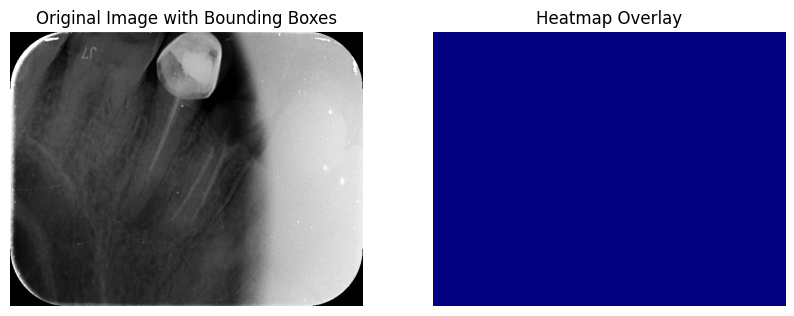

Processed and saved: ImageFile_8e067b6c-847e-43f9-944d-f7d078dab75d_000001851.png

0: 512x640 1 Complete endodontic treatment, 3 Total endodontic failures, 11.5ms
Speed: 3.4ms preprocess, 11.5ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


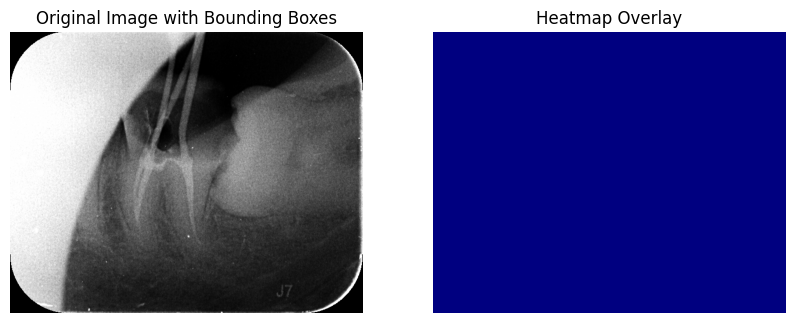

Processed and saved: ImageFile_0b465b46-2221-4565-9276-c2de8dcb68f3_000000981.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.4ms
Speed: 5.7ms preprocess, 9.4ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


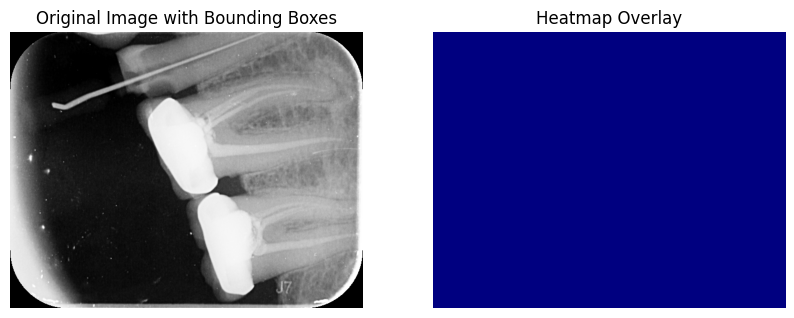

Processed and saved: ImageFile_36c0328a-9396-49fb-81ec-c7f83c02d23f_000001131.png

0: 512x640 3 Complete endodontic treatments, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 2 Total endodontic failures, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


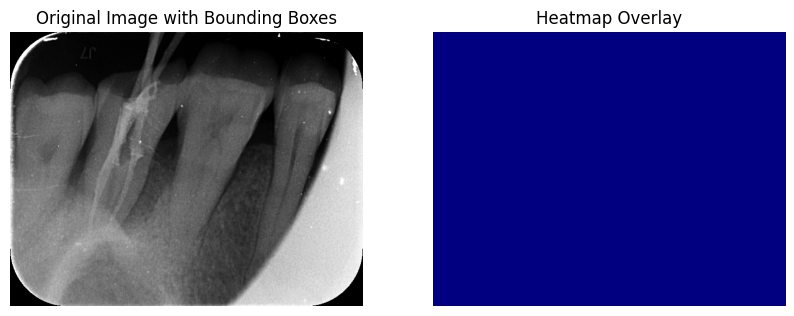

Processed and saved: ImageFile_1a51196c-98e0-44fa-b9b9-246837caa524_000002519.png

0: 512x640 2 Complete endodontic treatments, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.3ms
Speed: 3.1ms preprocess, 13.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


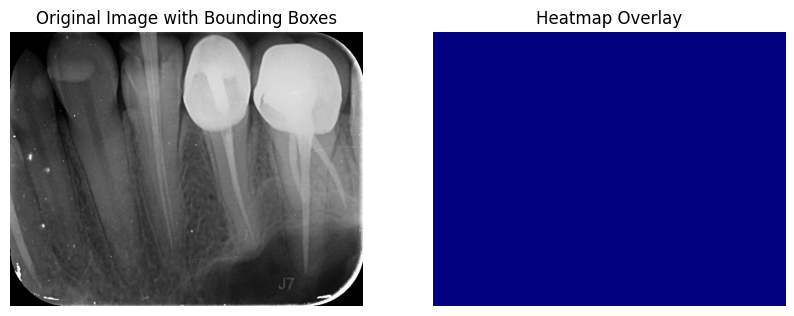

Processed and saved: ImageFile_79b958cd-0713-4405-b2bc-acdbfe11d39b_000001815.png

0: 512x640 2 Complete endodontic treatments, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.5ms
Speed: 3.4ms preprocess, 11.5ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


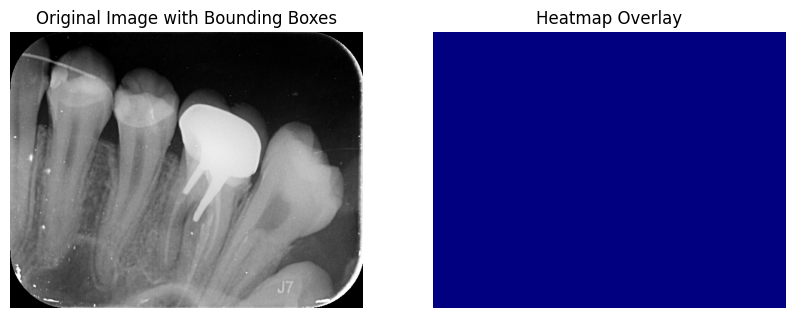

Processed and saved: ImageFile_2c9bb00f-099a-4a50-aecf-bc8fa8832023_000001223.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.8ms
Speed: 3.5ms preprocess, 11.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


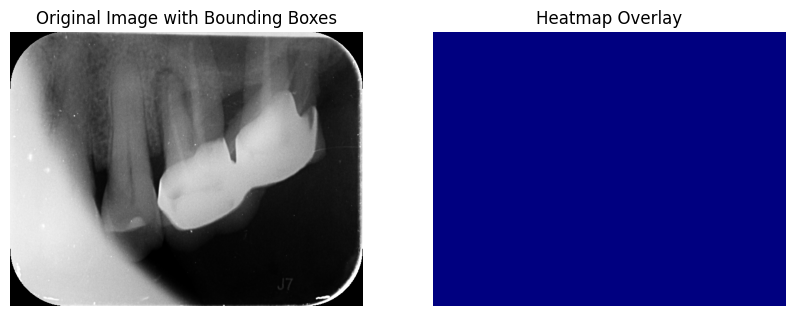

Processed and saved: ImageFile_30d8a58d-289e-41ba-b792-829cd8982843_000001825.png

0: 640x416 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 416)


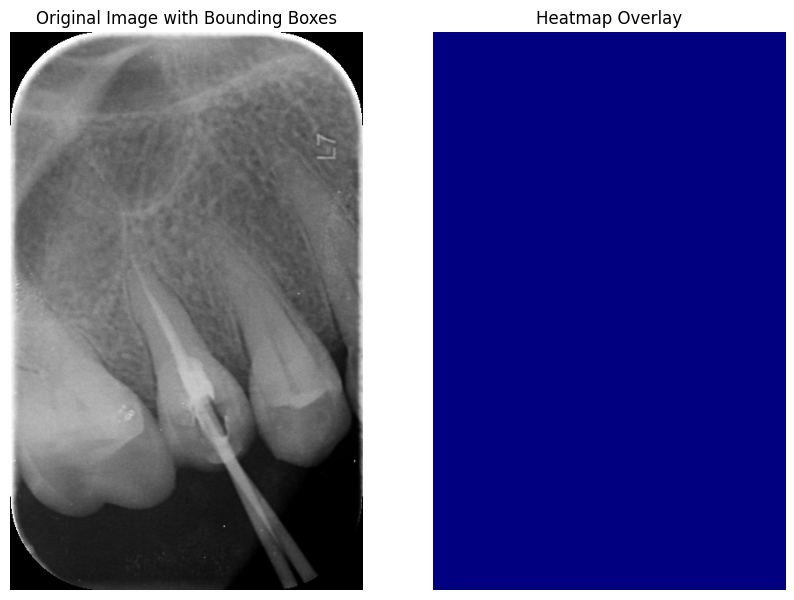

Processed and saved: ImageFile_0e080883-8fab-4ec6-af22-e945470efee6_000001767.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 2 Incomplete endodontic treatments, 1 Total endodontic failure, 9.8ms
Speed: 3.3ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


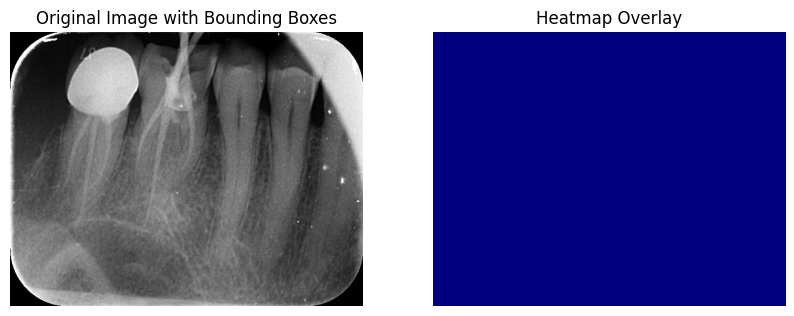

Processed and saved: ImageFile_56b650e0-5f46-4f36-833a-a0b1c4262db1_000001753.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 2 Incomplete endodontic treatments, 1 Total endodontic failure, 9.5ms
Speed: 4.7ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


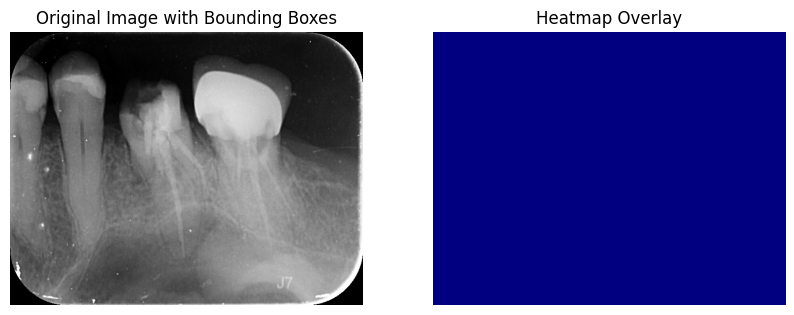

Processed and saved: ImageFile_2f8b4c0c-b04d-42dd-bb69-edc3be76cb96_000002321.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.9ms
Speed: 3.3ms preprocess, 11.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


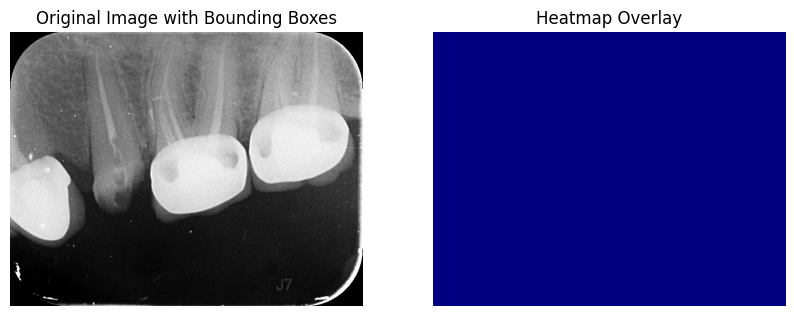

Processed and saved: ImageFile_4da6f479-6d14-42d9-9b21-49cde71f0bc9_000001409.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.8ms
Speed: 3.2ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


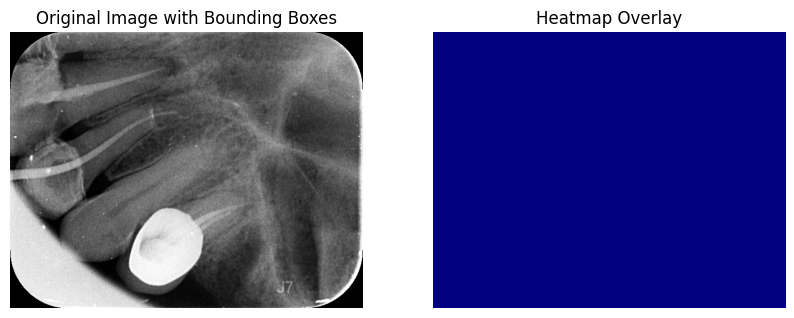

Processed and saved: ImageFile_70ba79c5-f012-42b1-a60d-0affa7bc7cac_000001073.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 14.3ms
Speed: 3.4ms preprocess, 14.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


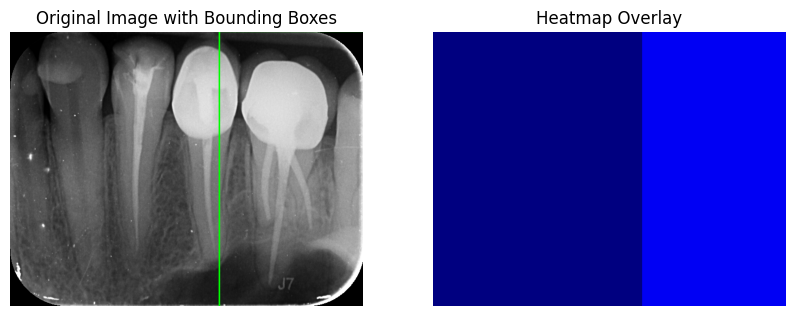

Processed and saved: ImageFile_6d978282-9318-4acc-a44d-a57534982947_000001819.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 2 Total endodontic failures, 10.8ms
Speed: 3.4ms preprocess, 10.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


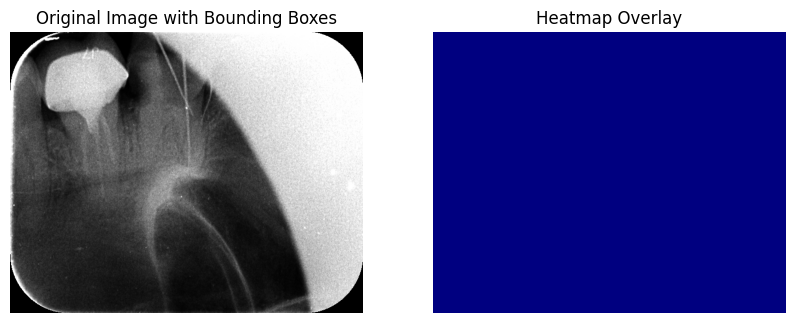

Processed and saved: ImageFile_3ff8fc79-8e04-496c-86c0-59f4396e540a_000001667.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Total endodontic failure, 12.8ms
Speed: 3.3ms preprocess, 12.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


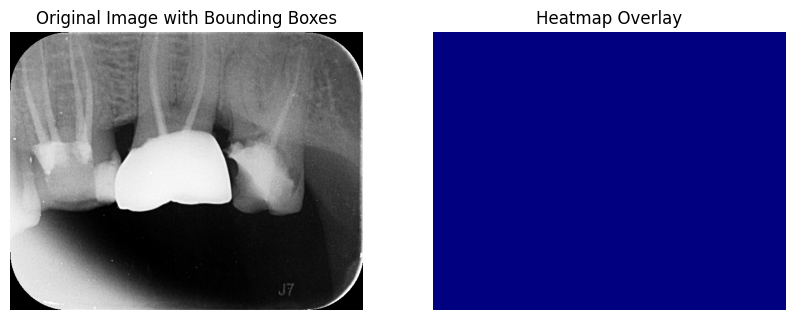

Processed and saved: ImageFile_0f5e78ea-8d52-4827-81a1-78968f212abb_000000133.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 16.1ms
Speed: 9.4ms preprocess, 16.1ms inference, 2.6ms postprocess per image at shape (1, 3, 512, 640)


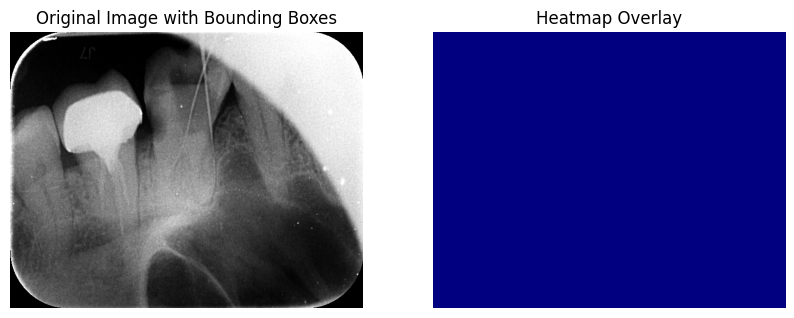

Processed and saved: ImageFile_7ef8826a-03d9-4f41-9538-14aa5a61ab29_000001663.png

0: 416x640 2 Complete endodontic treatments, 3 No endodontic treatments, 2 Incomplete endodontic treatments, 2 Total endodontic failures, 15.3ms
Speed: 2.7ms preprocess, 15.3ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


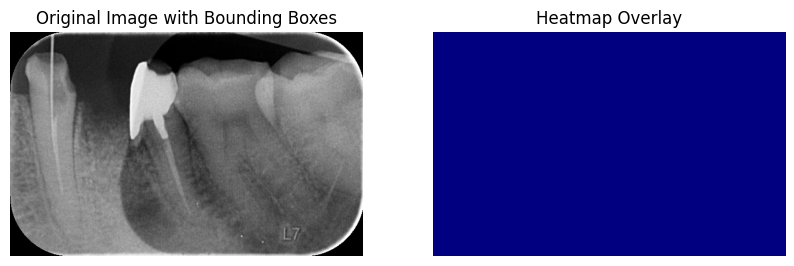

Processed and saved: ImageFile_8f5f510c-ac7f-4674-9126-8fb284748400_000000889.png

0: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.8ms
Speed: 1.7ms preprocess, 12.8ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


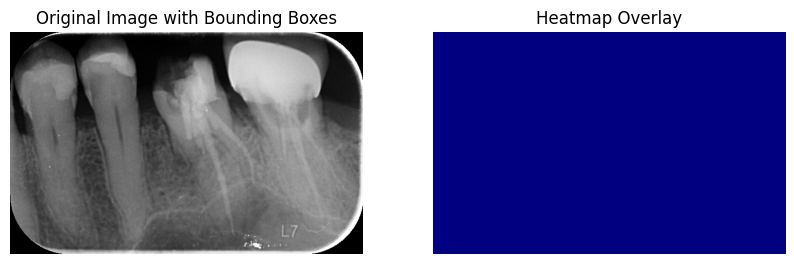

Processed and saved: ImageFile_10e26b66-db13-43d6-b569-ca7da15ed4c1_000002317.png

0: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.7ms
Speed: 3.3ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


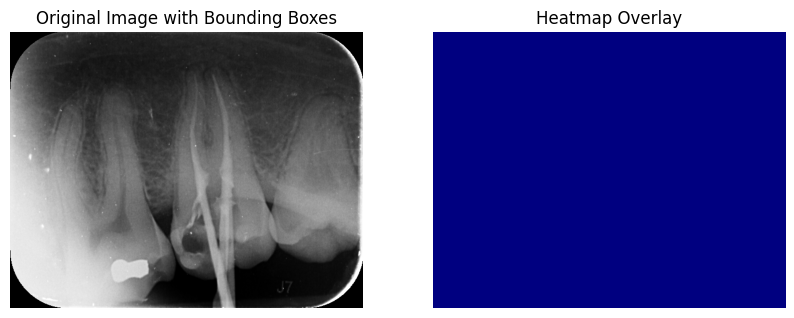

Processed and saved: ImageFile_0fc7be8c-f642-4887-ae54-38e2ff028107_000000959.png

0: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.5ms
Speed: 2.7ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


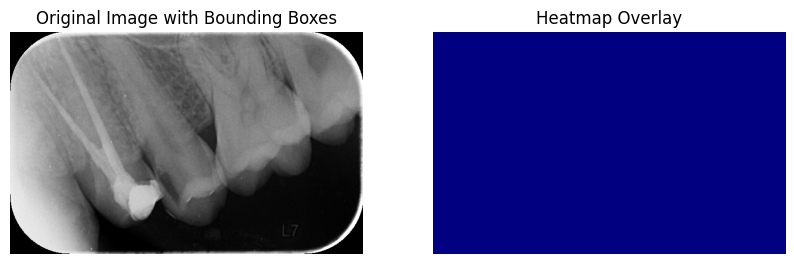

Processed and saved: ImageFile_0a75a2a5-3118-4239-9bfd-7a3b599769b2_000002121.png
Processing complete.


In [5]:
import cv2
from ultralytics import YOLO
import numpy as np
import os
import matplotlib.pyplot as plt

# Load YOLOv5 model (replace with the correct model file or version)
model = YOLO("/content/Models/YOLOv5.pt")  # Use YOLOv5s as an example

# Function to generate heatmap and draw bounding boxes
def generate_heatmap(image, results):
    # Get confidence scores and bounding boxes from the results
    confidence = results[0].boxes.conf.cpu().numpy()  # Confidence scores
    boxes = results[0].boxes.xywh.cpu().numpy()  # Bounding boxes (xywh)

    # Create an empty heatmap (same size as the image)
    heatmap = np.zeros_like(image, dtype=np.float32)

    # Apply the confidence scores as heatmap intensity at bounding box locations
    for box, conf in zip(boxes, confidence):
        x, y, w, h = box
        x1, y1 = int((x - w / 2) * image.shape[1]), int((y - h / 2) * image.shape[0])
        x2, y2 = int((x + w / 2) * image.shape[1]), int((y + h / 2) * image.shape[0])

        # Draw bounding boxes on the image
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green box with thickness 2

        # Apply the confidence scores as heatmap intensity at bounding box locations
        cv2.rectangle(heatmap, (x1, y1), (x2, y2), (conf * 255, 0, 0), -1)

    # Normalize heatmap and apply colormap
    heatmap = np.uint8(255 * heatmap / np.max(heatmap))  # Normalize to 0-255 range
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Combine heatmap with original image using alpha blending
    alpha = 0.6  # Blend ratio
    output = cv2.addWeighted(image, 1 - alpha, heatmap_colored, alpha, 0)

    return output, heatmap_colored  # Return both output and heatmap for plotting

# Path to the folder containing the images
image_folder = "/content/Images"
output_folder = "/content/COLORMAP_JET"
os.makedirs(output_folder, exist_ok=True)

# Process each image in the folder
for image_name in os.listdir(image_folder):
    image_path = os.path.join(image_folder, image_name)

    # Read the image
    im0 = cv2.imread(image_path)
    if im0 is None:
        print(f"Error reading image: {image_name}")
        continue

    # Perform detection with YOLOv5
    results = model(im0)

    # Generate heatmap on the image and draw bounding boxes
    heatmap_image, heatmap_colored = generate_heatmap(im0, results)

    # Save the result to the output folder
    output_path = os.path.join(output_folder, f"heatmap_{image_name}")
    cv2.imwrite(output_path, heatmap_image)

    # Plot the original image with heatmap overlay
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(im0, cv2.COLOR_BGR2RGB))
    plt.title("Original Image with Bounding Boxes")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB))
    plt.title("Heatmap Overlay")
    plt.axis('off')

    plt.show()

    print(f"Processed and saved: {image_name}")

print("Processing complete.")



image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0f5e78ea-8d52-4827-81a1-78968f212abb_000000133.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


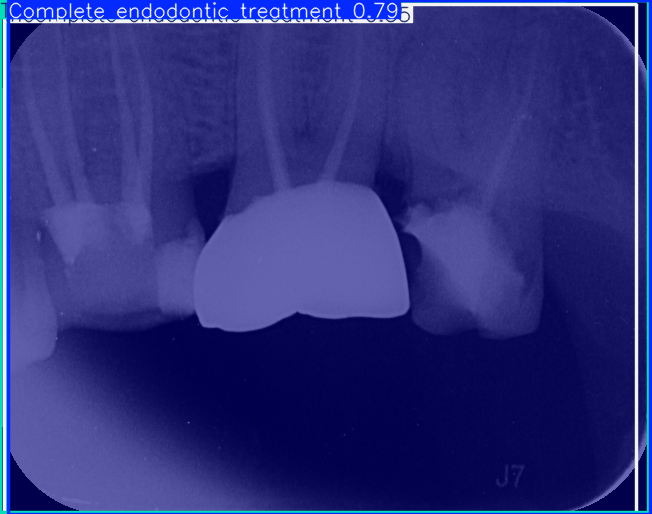

Processed and saved: heatmap_ImageFile_0f5e78ea-8d52-4827-81a1-78968f212abb_000000133.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0a75a2a5-3118-4239-9bfd-7a3b599769b2_000002121.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.1ms
Speed: 1.5ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


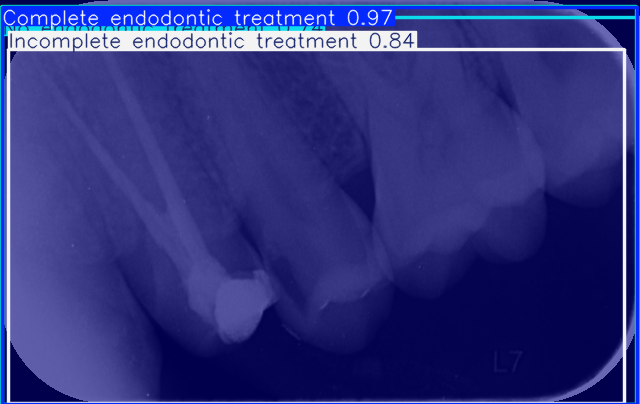

Processed and saved: heatmap_ImageFile_0a75a2a5-3118-4239-9bfd-7a3b599769b2_000002121.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_10e26b66-db13-43d6-b569-ca7da15ed4c1_000002317.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.6ms
Speed: 1.6ms preprocess, 10.6ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 640)


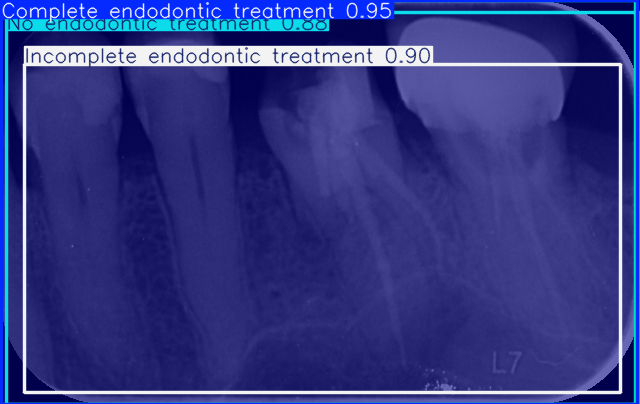

Processed and saved: heatmap_ImageFile_10e26b66-db13-43d6-b569-ca7da15ed4c1_000002317.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_56b650e0-5f46-4f36-833a-a0b1c4262db1_000001753.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.8ms
Speed: 3.3ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


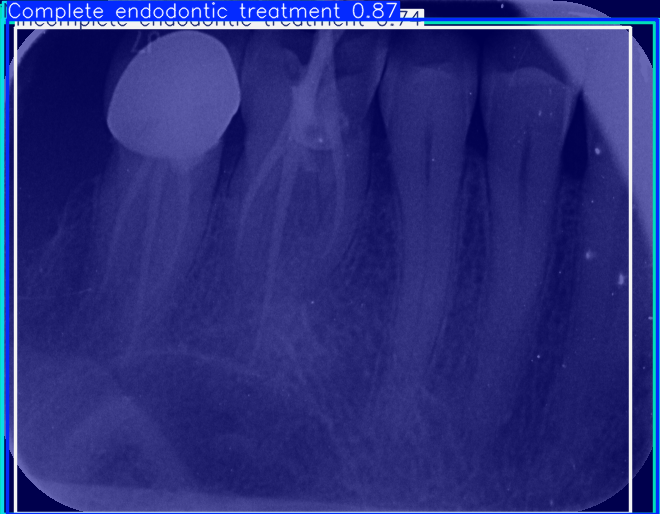

Processed and saved: heatmap_ImageFile_56b650e0-5f46-4f36-833a-a0b1c4262db1_000001753.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_80af4b6a-a214-49a7-b657-29faf3a500c6_000002101.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.5ms
Speed: 6.1ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


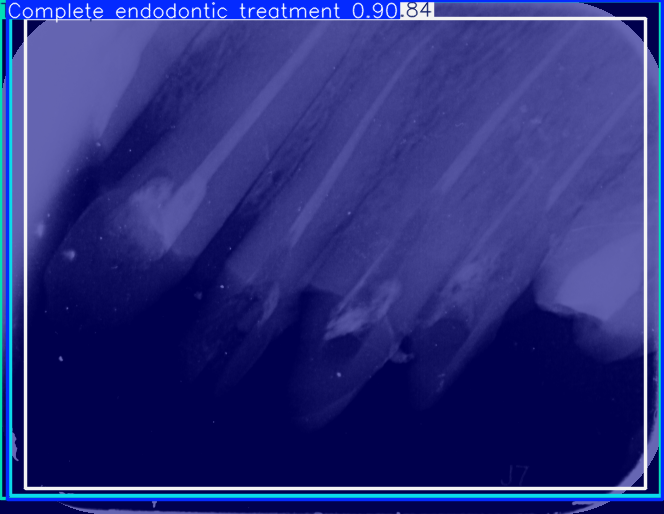

Processed and saved: heatmap_ImageFile_80af4b6a-a214-49a7-b657-29faf3a500c6_000002101.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_6d978282-9318-4acc-a44d-a57534982947_000001819.png: 512x640 2 Complete endodontic treatments, 2 No endodontic treatments, 2 Incomplete endodontic treatments, 2 Total endodontic failures, 14.9ms
Speed: 3.3ms preprocess, 14.9ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)


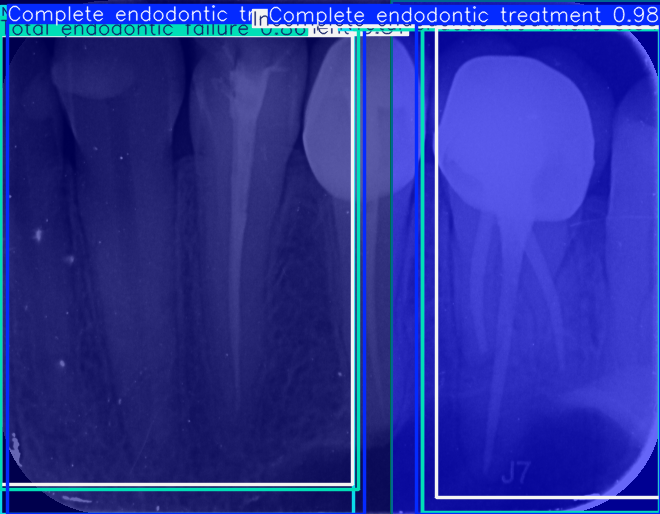

Processed and saved: heatmap_ImageFile_6d978282-9318-4acc-a44d-a57534982947_000001819.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_3ff8fc79-8e04-496c-86c0-59f4396e540a_000001667.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.4ms
Speed: 3.4ms preprocess, 10.4ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


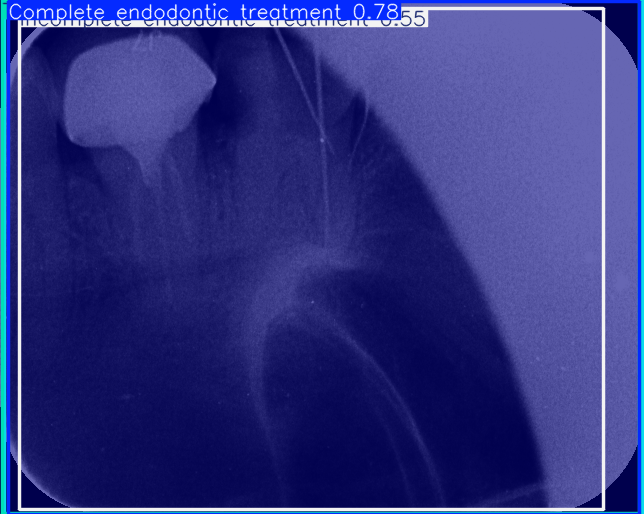

Processed and saved: heatmap_ImageFile_3ff8fc79-8e04-496c-86c0-59f4396e540a_000001667.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2cb9a1dc-3f64-4366-90b8-387e3c2c88c5_000002017.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.3ms
Speed: 3.2ms preprocess, 10.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


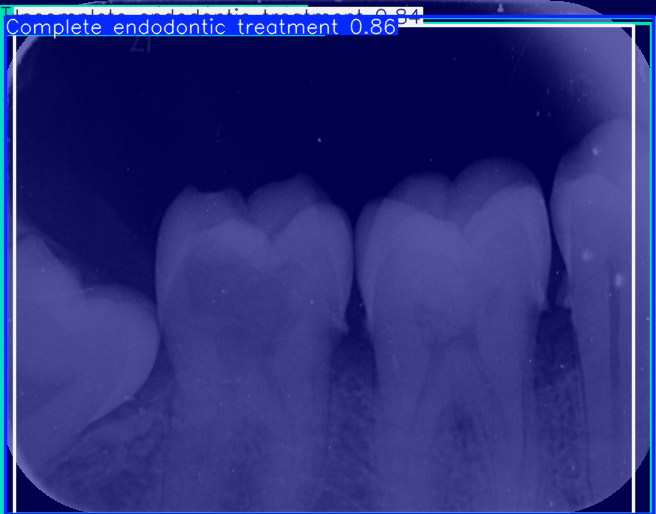

Processed and saved: heatmap_ImageFile_2cb9a1dc-3f64-4366-90b8-387e3c2c88c5_000002017.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_8f5f510c-ac7f-4674-9126-8fb284748400_000000889.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.9ms
Speed: 2.7ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


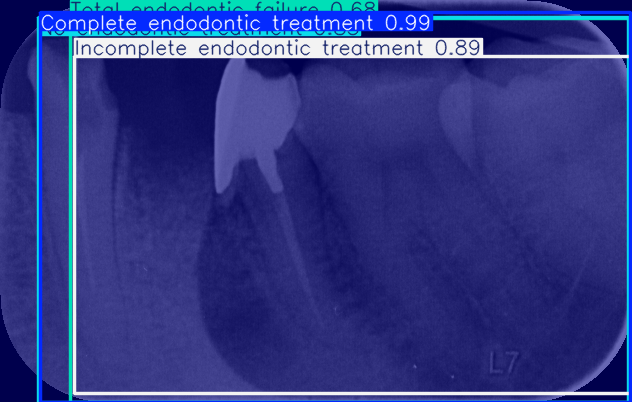

Processed and saved: heatmap_ImageFile_8f5f510c-ac7f-4674-9126-8fb284748400_000000889.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_78a3c7f1-c144-4d24-b158-fdabc5ce490d_000001241.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 14.0ms
Speed: 1.6ms preprocess, 14.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


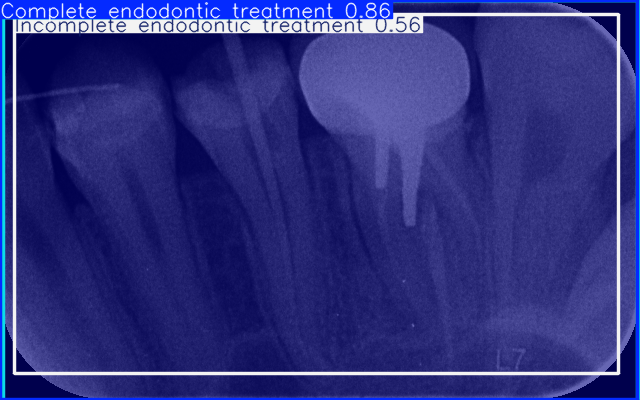

Processed and saved: heatmap_ImageFile_78a3c7f1-c144-4d24-b158-fdabc5ce490d_000001241.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_3a270fb4-5be2-47a4-bdd7-c2efb7629409_000000977.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.6ms
Speed: 2.7ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


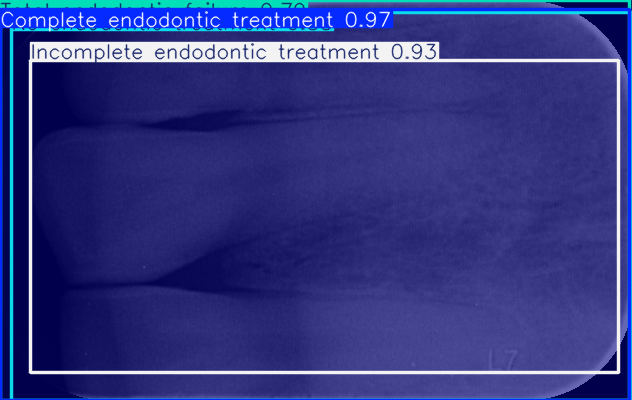

Processed and saved: heatmap_ImageFile_3a270fb4-5be2-47a4-bdd7-c2efb7629409_000000977.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_36c0328a-9396-49fb-81ec-c7f83c02d23f_000001131.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.1ms
Speed: 3.0ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


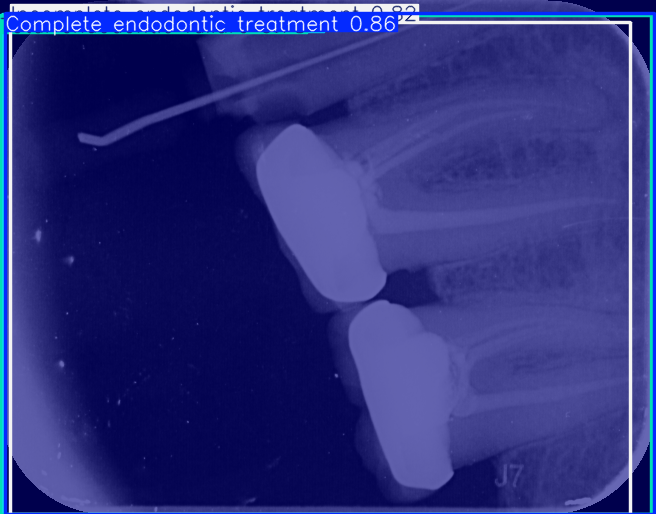

Processed and saved: heatmap_ImageFile_36c0328a-9396-49fb-81ec-c7f83c02d23f_000001131.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_1b8b6bf2-fb10-403b-b7b5-98f19c59b869_000000687.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.1ms
Speed: 3.1ms preprocess, 9.1ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


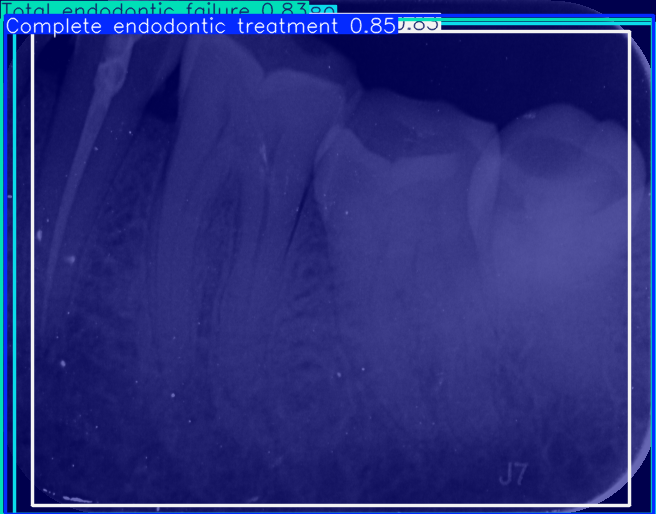

Processed and saved: heatmap_ImageFile_1b8b6bf2-fb10-403b-b7b5-98f19c59b869_000000687.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0a8f991d-8d12-416e-ba05-b19d8296bdce_000000541.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.3ms
Speed: 4.5ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


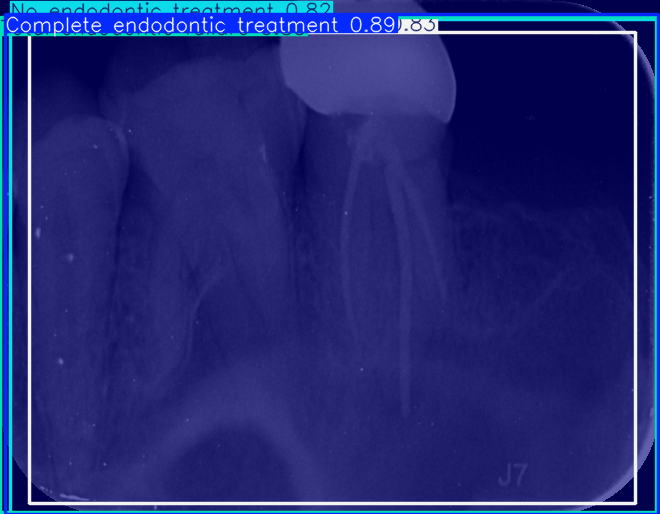

Processed and saved: heatmap_ImageFile_0a8f991d-8d12-416e-ba05-b19d8296bdce_000000541.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_4da6f479-6d14-42d9-9b21-49cde71f0bc9_000001409.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 17.9ms
Speed: 4.6ms preprocess, 17.9ms inference, 2.2ms postprocess per image at shape (1, 3, 512, 640)


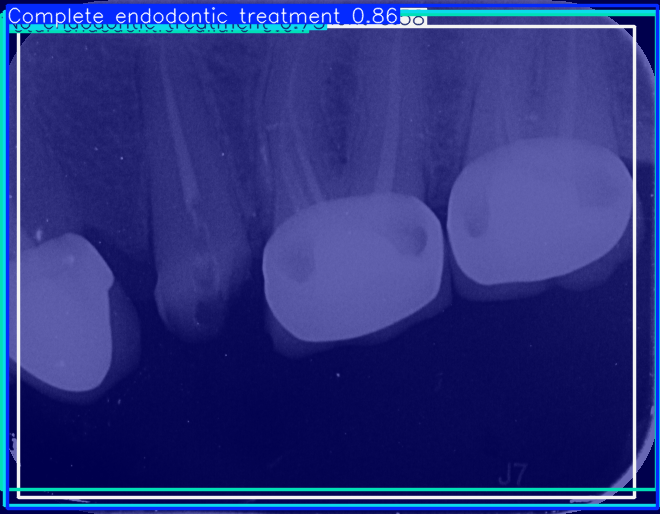

Processed and saved: heatmap_ImageFile_4da6f479-6d14-42d9-9b21-49cde71f0bc9_000001409.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_79b958cd-0713-4405-b2bc-acdbfe11d39b_000001815.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.6ms
Speed: 5.6ms preprocess, 11.6ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)


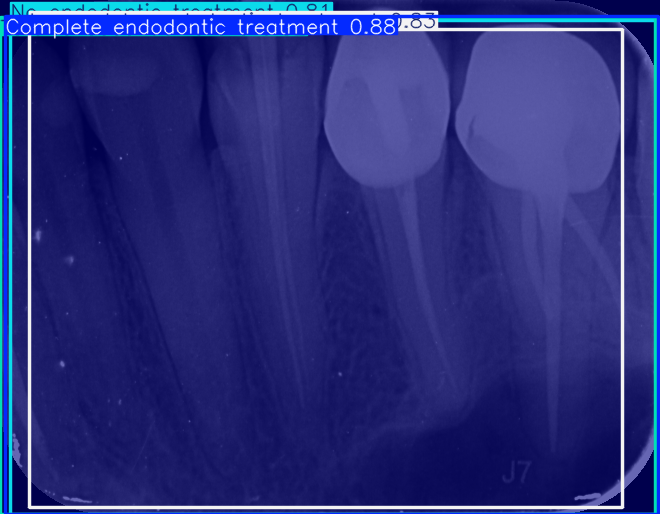

Processed and saved: heatmap_ImageFile_79b958cd-0713-4405-b2bc-acdbfe11d39b_000001815.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2fd65142-fab7-4151-bc25-c8c3c67895f2_000001525.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.7ms
Speed: 5.1ms preprocess, 12.7ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


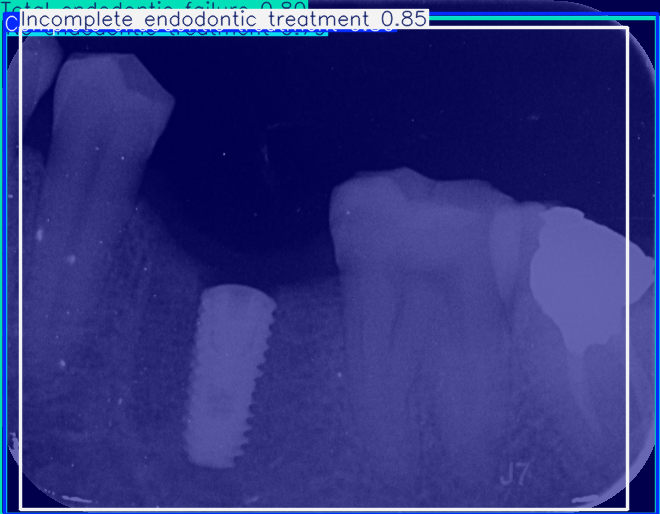

Processed and saved: heatmap_ImageFile_2fd65142-fab7-4151-bc25-c8c3c67895f2_000001525.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_02d8cab9-d575-42ba-918a-34533596e006_000001489.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.6ms
Speed: 5.3ms preprocess, 11.6ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


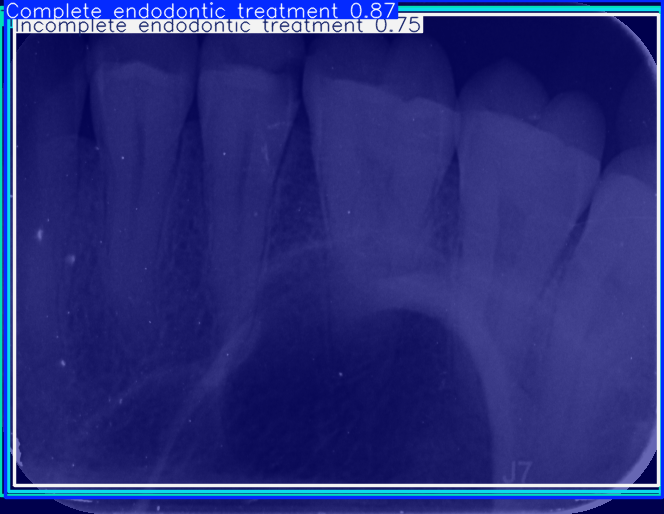

Processed and saved: heatmap_ImageFile_02d8cab9-d575-42ba-918a-34533596e006_000001489.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0e080883-8fab-4ec6-af22-e945470efee6_000001767.png: 640x416 1 Complete endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.9ms
Speed: 1.7ms preprocess, 12.9ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 416)


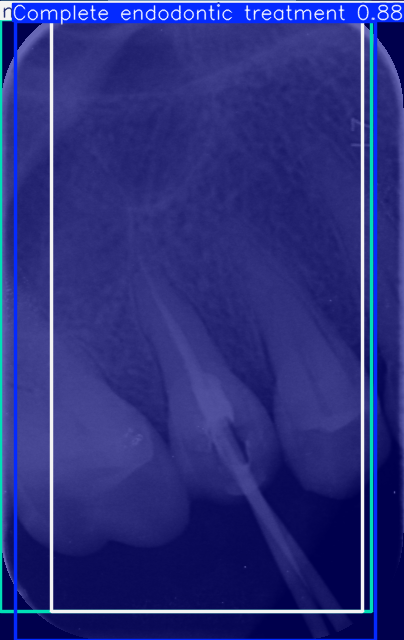

Processed and saved: heatmap_ImageFile_0e080883-8fab-4ec6-af22-e945470efee6_000001767.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_7ef8826a-03d9-4f41-9538-14aa5a61ab29_000001663.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.3ms
Speed: 3.1ms preprocess, 12.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


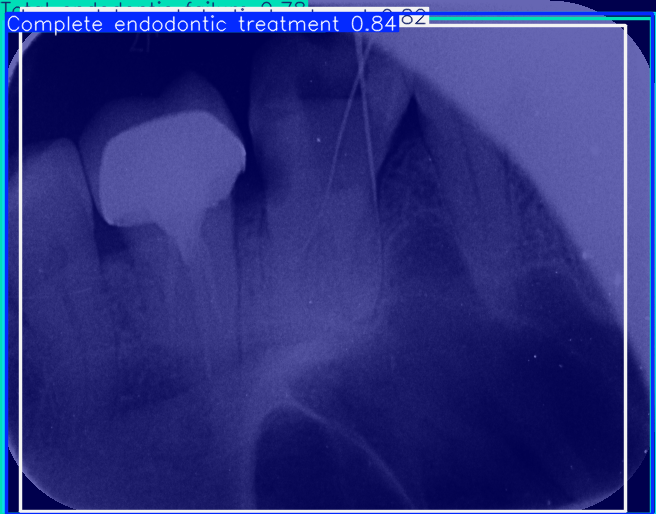

Processed and saved: heatmap_ImageFile_7ef8826a-03d9-4f41-9538-14aa5a61ab29_000001663.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_68ac7f1f-8b34-40f4-ac07-59c85d7388d4_000001745.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.4ms
Speed: 5.2ms preprocess, 11.4ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


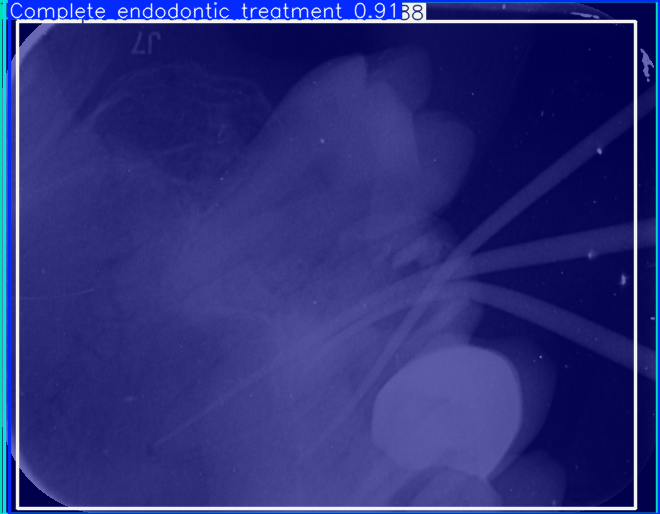

Processed and saved: heatmap_ImageFile_68ac7f1f-8b34-40f4-ac07-59c85d7388d4_000001745.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_8e067b6c-847e-43f9-944d-f7d078dab75d_000001851.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.3ms
Speed: 4.9ms preprocess, 12.3ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


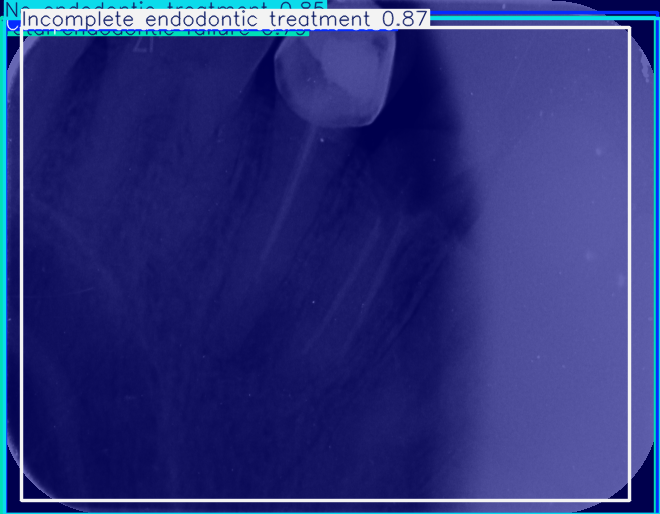

Processed and saved: heatmap_ImageFile_8e067b6c-847e-43f9-944d-f7d078dab75d_000001851.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_1bcb6cd0-8b3a-483f-8b5b-0fc24c2c61a3_000001387.png: 640x512 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.0ms
Speed: 5.3ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 512)


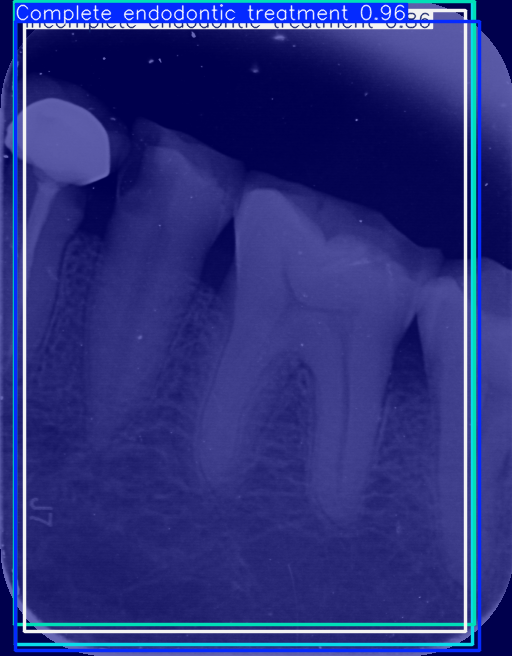

Processed and saved: heatmap_ImageFile_1bcb6cd0-8b3a-483f-8b5b-0fc24c2c61a3_000001387.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2b11eb83-0d85-4802-b3b9-e522f5163f21_000001863.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.3ms
Speed: 2.8ms preprocess, 11.3ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


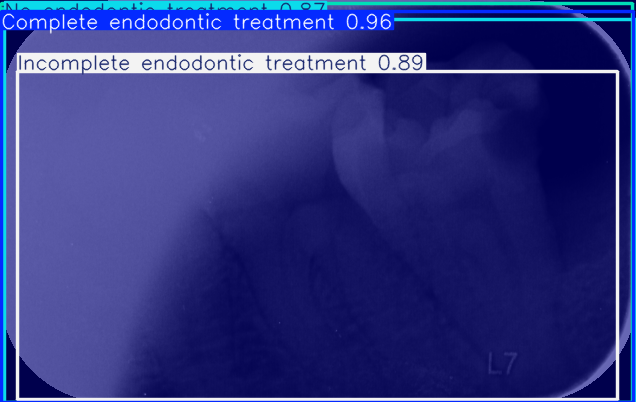

Processed and saved: heatmap_ImageFile_2b11eb83-0d85-4802-b3b9-e522f5163f21_000001863.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_30d8a58d-289e-41ba-b792-829cd8982843_000001825.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 14.2ms
Speed: 5.1ms preprocess, 14.2ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


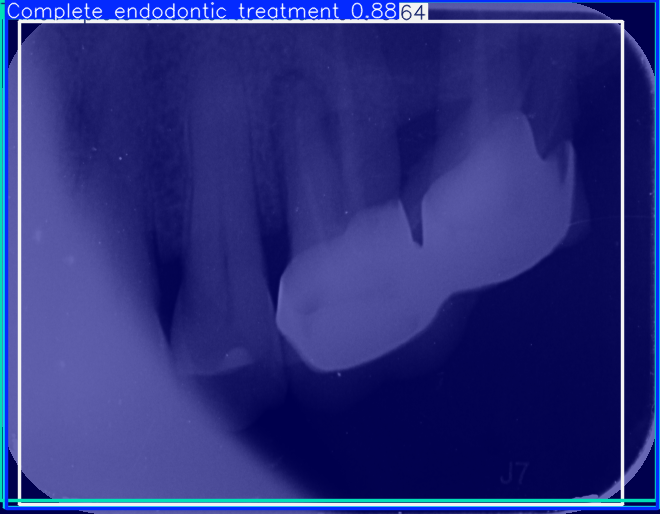

Processed and saved: heatmap_ImageFile_30d8a58d-289e-41ba-b792-829cd8982843_000001825.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2b643020-674a-4022-8ccc-fe79b11c1615_000002407.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.3ms
Speed: 3.2ms preprocess, 12.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


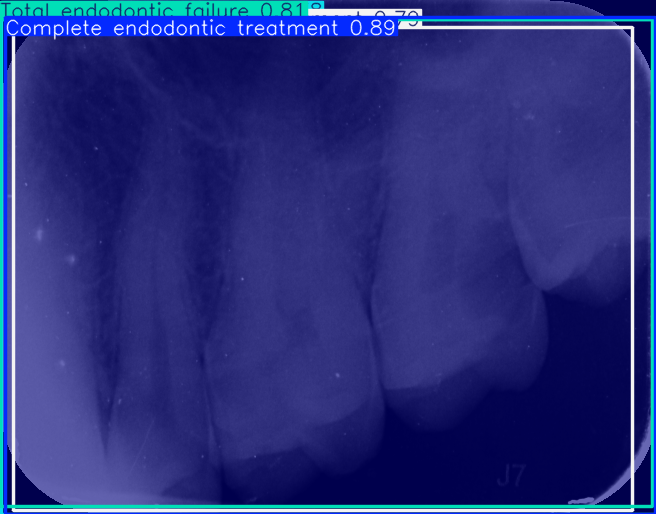

Processed and saved: heatmap_ImageFile_2b643020-674a-4022-8ccc-fe79b11c1615_000002407.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_9a5a780f-1e93-4f33-ac66-7d3f2f175278_000000347.png: 576x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.1ms
Speed: 5.4ms preprocess, 10.1ms inference, 3.5ms postprocess per image at shape (1, 3, 576, 640)


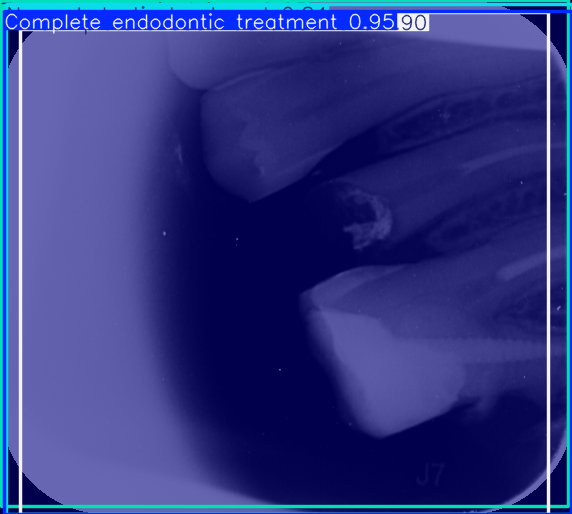

Processed and saved: heatmap_ImageFile_9a5a780f-1e93-4f33-ac66-7d3f2f175278_000000347.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_7b35f871-f4c6-4e35-a214-cd3b64ce5c56_000001461.png: 640x416 1 Complete endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.8ms
Speed: 2.7ms preprocess, 12.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 416)


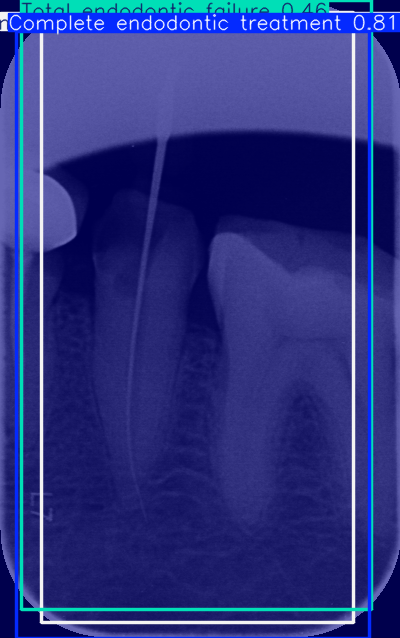

Processed and saved: heatmap_ImageFile_7b35f871-f4c6-4e35-a214-cd3b64ce5c56_000001461.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_1a51196c-98e0-44fa-b9b9-246837caa524_000002519.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.9ms
Speed: 4.8ms preprocess, 13.9ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)


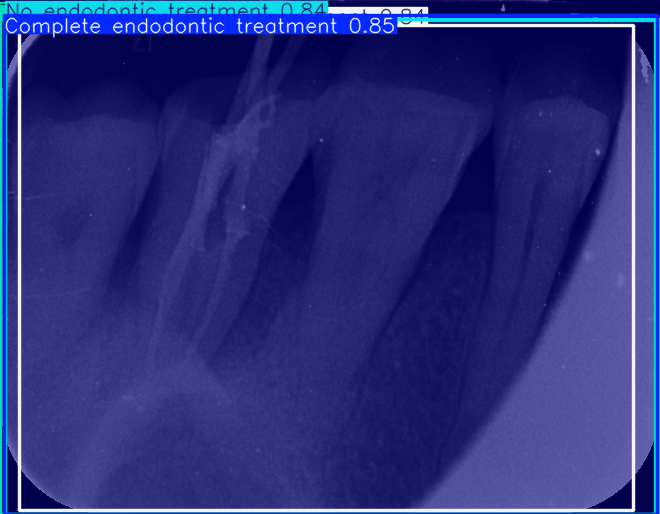

Processed and saved: heatmap_ImageFile_1a51196c-98e0-44fa-b9b9-246837caa524_000002519.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_8fa23452-8011-459e-990d-e4c191786582_000001811.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.8ms
Speed: 3.1ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


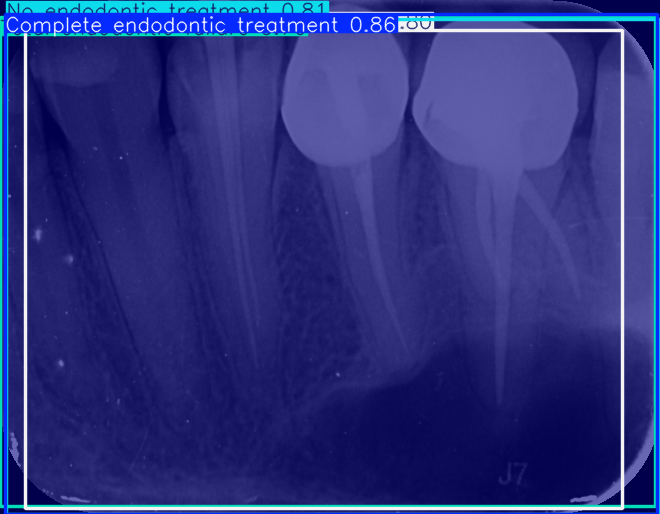

Processed and saved: heatmap_ImageFile_8fa23452-8011-459e-990d-e4c191786582_000001811.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_1d4a6ff3-47bd-4a12-a72a-712ac8fe25b1_000002193.png: 448x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.2ms
Speed: 1.5ms preprocess, 12.2ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


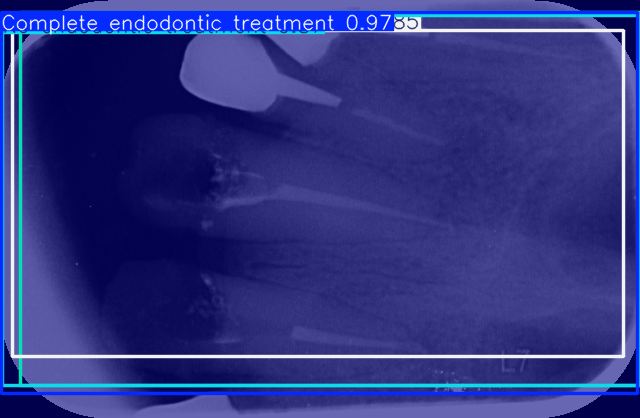

Processed and saved: heatmap_ImageFile_1d4a6ff3-47bd-4a12-a72a-712ac8fe25b1_000002193.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_7d480b1e-d50c-4dac-b733-bb2e6019b18e_000001689.png: 416x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.8ms
Speed: 2.6ms preprocess, 13.8ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 640)


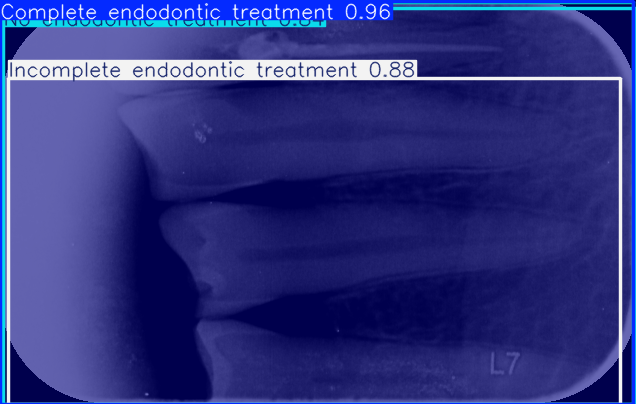

Processed and saved: heatmap_ImageFile_7d480b1e-d50c-4dac-b733-bb2e6019b18e_000001689.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0fc7be8c-f642-4887-ae54-38e2ff028107_000000959.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.5ms
Speed: 5.3ms preprocess, 12.5ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)


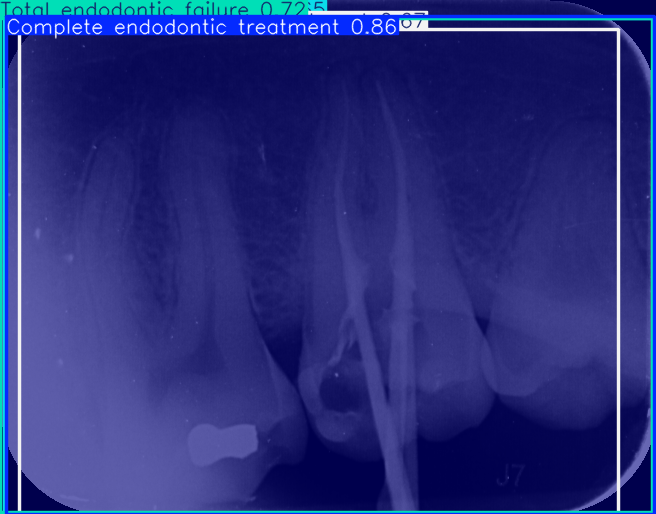

Processed and saved: heatmap_ImageFile_0fc7be8c-f642-4887-ae54-38e2ff028107_000000959.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2c9bb00f-099a-4a50-aecf-bc8fa8832023_000001223.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.1ms
Speed: 5.2ms preprocess, 9.1ms inference, 3.7ms postprocess per image at shape (1, 3, 512, 640)


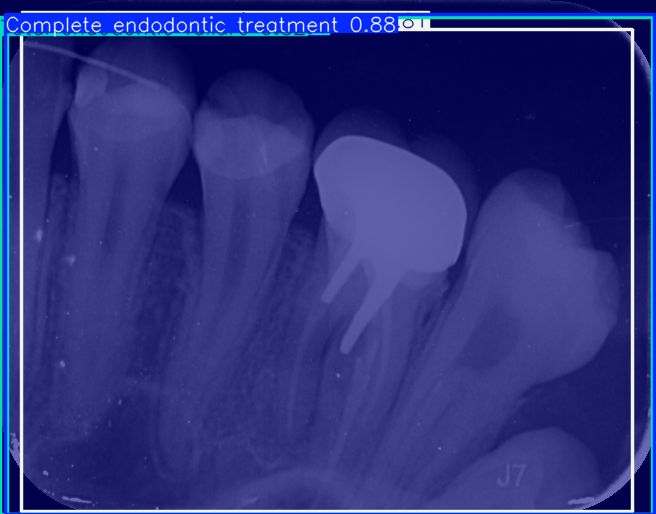

Processed and saved: heatmap_ImageFile_2c9bb00f-099a-4a50-aecf-bc8fa8832023_000001223.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_2f8b4c0c-b04d-42dd-bb69-edc3be76cb96_000002321.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 9.4ms
Speed: 3.2ms preprocess, 9.4ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


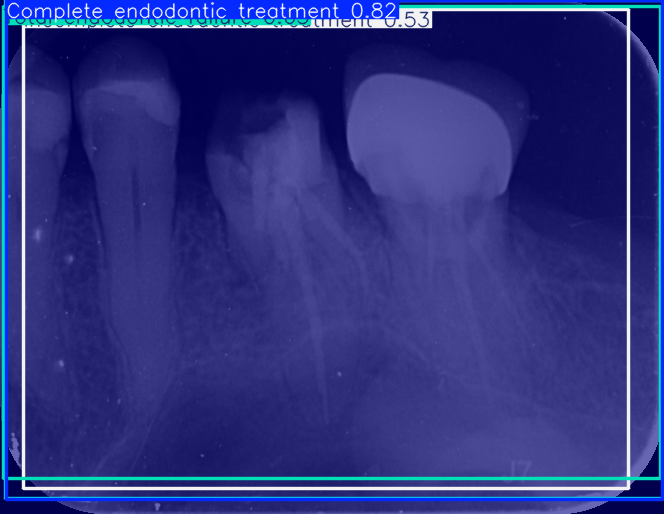

Processed and saved: heatmap_ImageFile_2f8b4c0c-b04d-42dd-bb69-edc3be76cb96_000002321.png

image 1/1 /content/COLORMAP_JET/heatmap_001336.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.7ms
Speed: 3.8ms preprocess, 13.7ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


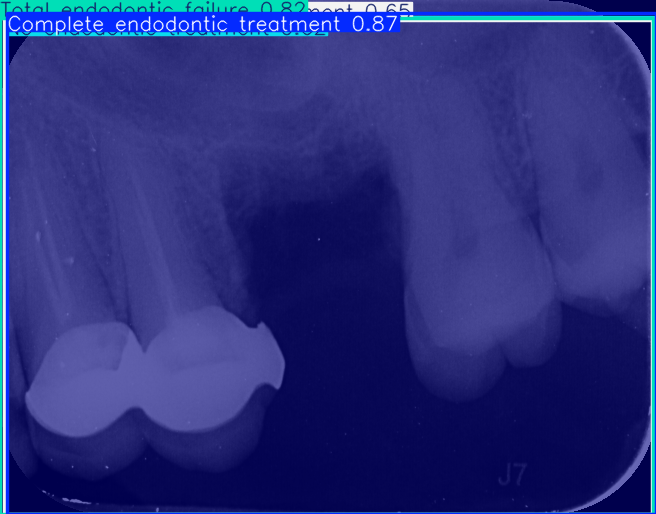

Processed and saved: heatmap_001336.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0ed3b649-650b-4ec0-b630-1eaf41872b1d_000001883.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.5ms
Speed: 3.5ms preprocess, 12.5ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 640)


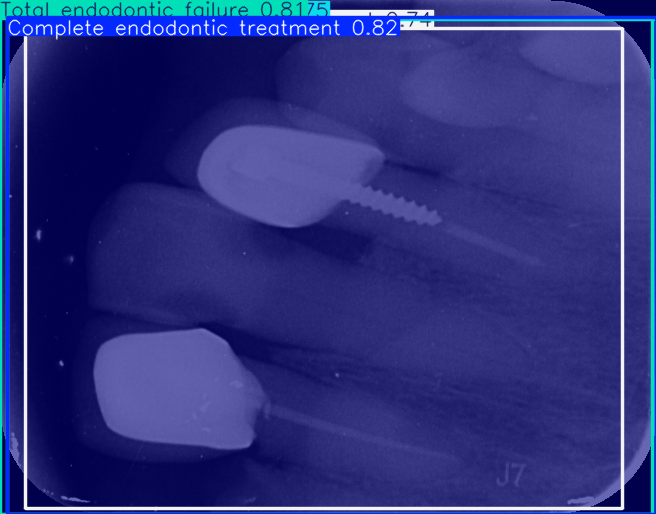

Processed and saved: heatmap_ImageFile_0ed3b649-650b-4ec0-b630-1eaf41872b1d_000001883.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_8c86fde0-f3e6-4032-91d9-eba9b5f6142c_000001953.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 10.9ms
Speed: 3.3ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


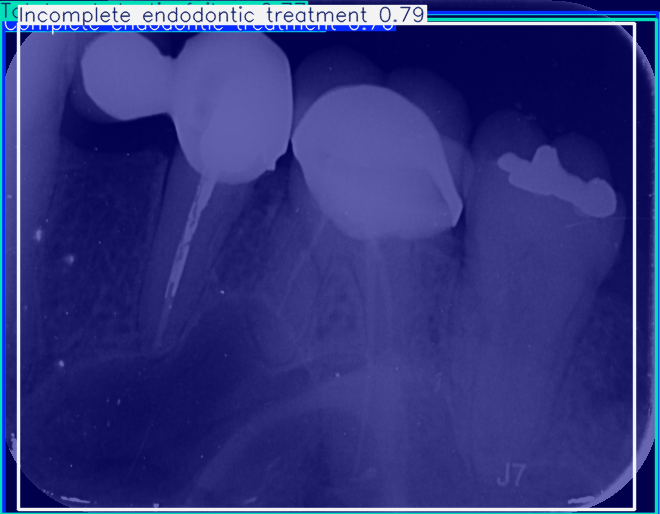

Processed and saved: heatmap_ImageFile_8c86fde0-f3e6-4032-91d9-eba9b5f6142c_000001953.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_0b465b46-2221-4565-9276-c2de8dcb68f3_000000981.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 11.7ms
Speed: 5.2ms preprocess, 11.7ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


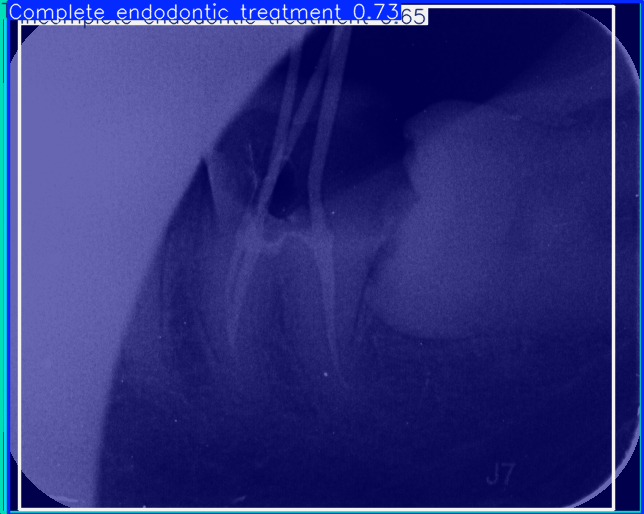

Processed and saved: heatmap_ImageFile_0b465b46-2221-4565-9276-c2de8dcb68f3_000000981.png

image 1/1 /content/COLORMAP_JET/heatmap_ImageFile_70ba79c5-f012-42b1-a60d-0affa7bc7cac_000001073.png: 512x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 12.2ms
Speed: 6.1ms preprocess, 12.2ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


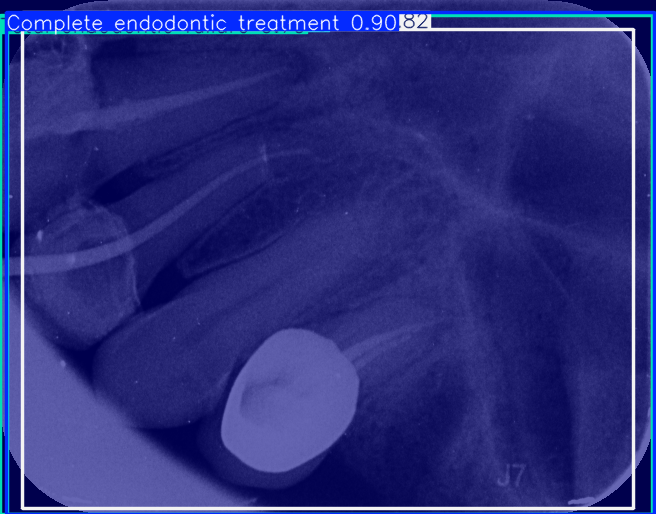

Processed and saved: heatmap_ImageFile_70ba79c5-f012-42b1-a60d-0affa7bc7cac_000001073.png
Processing complete.


In [6]:
import os
from ultralytics import YOLO

# Load the model
model = YOLO("/content/Models/YOLOv5.pt")  # Use YOLOv5s as an example

# Path to the folder containing the images
image_folder = "/content/COLORMAP_JET"
output_folder = "/content/Results"
os.makedirs(output_folder, exist_ok=True)

# Get all image files in the folder (ensure they are image files by checking extensions)
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(image_folder, image_file)

    # Run inference on the image
    results = model(image_path)  # Batched inference with a single image path

    # Process the result
    for result in results:
        boxes = result.boxes  # Boxes object for bounding box outputs
        masks = result.masks  # Masks object for segmentation masks outputs
        keypoints = result.keypoints  # Keypoints object for pose outputs
        probs = result.probs  # Probs object for classification outputs
        obb = result.obb  # Oriented boxes object for OBB outputs

        # Show the results (visualize on screen)
        result.show()

        # Save the result to the output folder
        output_path = os.path.join(output_folder, f"result_{image_file}")
        result.save(filename=output_path)  # Save to disk

    print(f"Processed and saved: {image_file}")

print("Processing complete.")


In [7]:
import shutil

# Path to the directory you want to zip
dir_path = '/content/Results'
zip_file_path = '/content/Results.zip'

# Create a zip file
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', dir_path)

# Now, you can download the zip file
from google.colab import files
files.download(zip_file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
!unzip /content/heatmap_images.zip

Archive:  /content/heatmap_images.zip
  inflating: heatmap images/h1.png   
  inflating: heatmap images/h2.png   
  inflating: heatmap images/h3.png   
  inflating: heatmap images/h4.png   



0: 352x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 640)


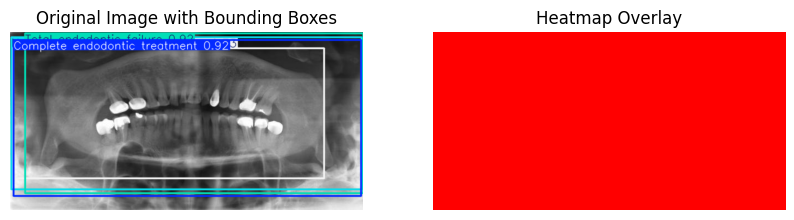

Processed and saved: h1.png

0: 352x640 1 Complete endodontic treatment, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 17.7ms
Speed: 1.5ms preprocess, 17.7ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)


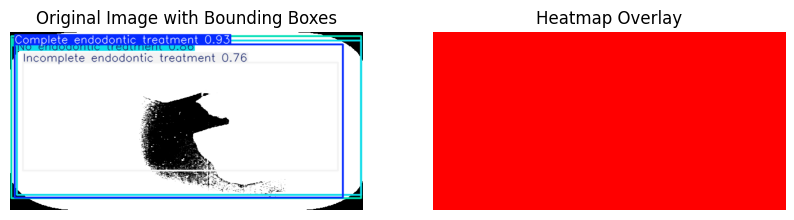

Processed and saved: h4.png

0: 352x640 2 Complete endodontic treatments, 1 No endodontic treatment, 1 Incomplete endodontic treatment, 1 Total endodontic failure, 13.7ms
Speed: 4.3ms preprocess, 13.7ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)


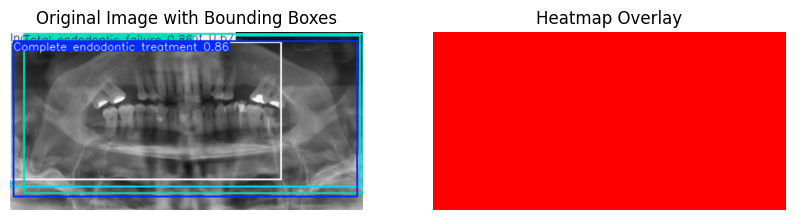

Processed and saved: h2.png

0: 352x640 1 Complete endodontic treatment, 1 Total endodontic failure, 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)


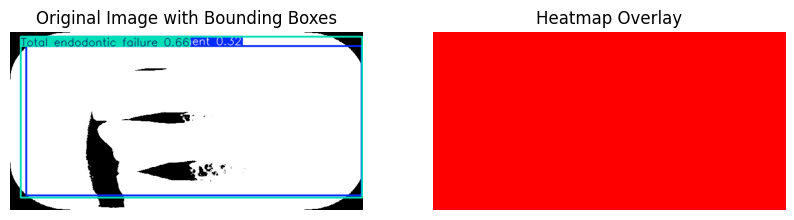

Processed and saved: h3.png
Processing complete.


In [16]:
import cv2
from ultralytics import YOLO
import numpy as np
import os
import matplotlib.pyplot as plt

# Load YOLOv5 model (replace with the correct model file or version)
model = YOLO("/content/Models/YOLOv5.pt")  # Use YOLOv5s as an example

# Function to generate heatmap and draw bounding boxes
def generate_heatmap(image, results):
    # Get confidence scores and bounding boxes from the results
    confidence = results[0].boxes.conf.cpu().numpy()  # Confidence scores
    boxes = results[0].boxes.xywh.cpu().numpy()  # Bounding boxes (xywh)

    # Create an empty heatmap (same size as the image)
    heatmap = np.zeros_like(image, dtype=np.float32)

    # Apply the confidence scores as heatmap intensity at bounding box locations
    for box, conf in zip(boxes, confidence):
        x, y, w, h = box
        x1, y1 = int((x - w / 2) * image.shape[1]), int((y - h / 2) * image.shape[0])
        x2, y2 = int((x + w / 2) * image.shape[1]), int((y + h / 2) * image.shape[0])

        # Draw bounding boxes on the image
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green box with thickness 2

        # Apply the confidence scores as heatmap intensity at bounding box locations
        cv2.rectangle(heatmap, (x1, y1), (x2, y2), (conf * 255, 0, 0), -1)

    # Normalize heatmap and apply colormap
    heatmap = np.uint8(255 * heatmap / np.max(heatmap))  # Normalize to 0-255 range
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_RAINBOW)

    # Combine heatmap with original image using alpha blending
    alpha = 0.6  # Blend ratio
    output = cv2.addWeighted(image, 1 - alpha, heatmap_colored, alpha, 0)

    return output, heatmap_colored  # Return both output and heatmap for plotting

# Path to the folder containing the images
image_folder = "/content/heatmap images"
output_folder = "/content/COLORMAP_RAINBOW"
os.makedirs(output_folder, exist_ok=True)

# Process each image in the folder
for image_name in os.listdir(image_folder):
    image_path = os.path.join(image_folder, image_name)

    # Read the image
    im0 = cv2.imread(image_path)
    if im0 is None:
        print(f"Error reading image: {image_name}")
        continue

    # Perform detection with YOLOv5
    results = model(im0)

    # Generate heatmap on the image and draw bounding boxes
    heatmap_image, heatmap_colored = generate_heatmap(im0, results)

    # Save the result to the output folder
    output_path = os.path.join(output_folder, f"heatmap_{image_name}")
    cv2.imwrite(output_path, heatmap_image)

    # Plot the original image with heatmap overlay
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(im0, cv2.COLOR_BGR2RGB))
    plt.title("Original Image with Bounding Boxes")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB))
    plt.title("Heatmap Overlay")
    plt.axis('off')

    plt.show()

    print(f"Processed and saved: {image_name}")

print("Processing complete.")


In [17]:
import shutil

# Path to the directory you want to zip
dir_path = '/content/COLORMAP_RAINBOW'
zip_file_path = '/content/COLORMAP_RAINBOW.zip'

# Create a zip file
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', dir_path)

# Now, you can download the zip file
from google.colab import files
files.download(zip_file_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>